![alt text](logo.png "Logo")

Notebook con algunos ejemplos usando Sunpy

In [1]:
import warnings
warnings.filterwarnings('ignore')

Estas líneas ignoran los warnings que tienen algunas funciones

In [2]:
import numpy as np
import sunpy.map as smap
from sunpy.coordinates import frames
from sunpy.net import Fido, attrs as a
from astropy import units as u
from astropy.coordinates import SkyCoord
import sunpy.timeseries as ts
import matplotlib.pyplot as plt

In [3]:
plt.rcParams['figure.figsize'] = (16,8)

## Consiguiendo datos y jugando con ellos

En este notebook de ejemplo, repasaremos los conceptos básicos del uso de SunPy para acceder, descargar, cargar y analizar datos solares.

Primero veremos cómo FIDO de SunPy nos permite buscar y descargar datos, y cómo podemos realizar diferentes tipos de busquedas. Luego veremos cómo podemos cargar y analizar datos de mapas o series de tiempo usando los módulos de SunPy Map en coordenadas específicas o SunPy TimeSeries para las series temporales.

¡Primero busquemos y descarguemos datos!

In [4]:
#Ejemplo buscando datos SDO/AIA en un rango de tiempo.
results = Fido.search(a.Time('2014/09/19 05:17', '2014/09/19 07:15'), a.Instrument('AIA'))

En este caso, *results* es un objeto UnifiedResponse que almacena la información para la descarga

In [5]:
results

Start Time,End Time,Source,Instrument,Wavelength [2],Provider,Physobs,Wavetype,Extent Width,Extent Length,Extent Type,Size,Info
,,,,Angstrom,,,,,,,Mibyte,
object,object,str3,str3,float64,str4,str9,str6,str4,str4,str8,float64,str67
2014-09-19 05:17:01.000,2014-09-19 05:17:02.000,SDO,AIA,94.0 .. 94.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.902 exposure] [100.00 percentd]"
2014-09-19 05:17:02.000,2014-09-19 05:17:03.000,SDO,AIA,335.0 .. 335.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.901 exposure] [100.00 percentd]"
2014-09-19 05:17:04.000,2014-09-19 05:17:05.000,SDO,AIA,1600.0 .. 1600.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.901 exposure] [100.00 percentd]"
2014-09-19 05:17:06.000,2014-09-19 05:17:07.000,SDO,AIA,193.0 .. 193.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.000 exposure] [100.00 percentd]"
2014-09-19 05:17:07.000,2014-09-19 05:17:08.000,SDO,AIA,304.0 .. 304.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.901 exposure] [100.00 percentd]"
2014-09-19 05:17:08.000,2014-09-19 05:17:09.000,SDO,AIA,131.0 .. 131.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.901 exposure] [100.00 percentd]"
...,...,...,...,...,...,...,...,...,...,...,...,...
2014-09-19 07:14:50.000,2014-09-19 07:14:51.000,SDO,AIA,335.0 .. 335.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [2.901 exposure] [100.00 percentd]"


Para averiguar cuántos archivos son retornados se puede usar el atributo *.file_num*

In [6]:
results.file_num

4720

In [52]:
4720*12/1024

55.3125

Fido puede hacer búsquedas más específicas utilizando otros atributos. Por ejemplo, se puede reducir la búsqueda para ver solo una longitud de onda, con una cadencia de 2 minutos.

In [7]:
results = Fido.search(a.Time('2014/09/19 05:17', '2014/09/19 05:27'), a.Instrument('AIA'), 
                      a.Wavelength(170*u.nm), a.vso.Sample(2*u.minute))

In [8]:
results

Start Time,End Time,Source,Instrument,Wavelength [2],Provider,Physobs,Wavetype,Extent Width,Extent Length,Extent Type,Size,Info
,,,,Angstrom,,,,,,,Mibyte,
object,object,str3,str3,float64,str4,str9,str6,str4,str4,str8,float64,str57
2014-09-19 05:17:18.000,2014-09-19 05:17:19.000,SDO,AIA,1700.0 .. 1700.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [1.000 exposure] [100.00 percentd]"
2014-09-19 05:19:18.000,2014-09-19 05:19:19.000,SDO,AIA,1700.0 .. 1700.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [1.000 exposure] [100.00 percentd]"
2014-09-19 05:21:18.000,2014-09-19 05:21:19.000,SDO,AIA,1700.0 .. 1700.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [1.000 exposure] [100.00 percentd]"
2014-09-19 05:23:18.000,2014-09-19 05:23:19.000,SDO,AIA,1700.0 .. 1700.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [1.000 exposure] [100.00 percentd]"
2014-09-19 05:25:18.000,2014-09-19 05:25:19.000,SDO,AIA,1700.0 .. 1700.0,JSOC,intensity,NARROW,4096,4096,FULLDISK,64.64844,"AIA level 1, 4096x4096 [1.000 exposure] [100.00 percentd]"


Procedamos a descargar los datos con la función de Fido *fetch*

In [9]:
aia_files = Fido.fetch(results)

Files Downloaded:   0%|          | 0/5 [00:00<?, ?file/s]

Así como está la línea anterior, se van a descargar en la carpeta por defecto definida en el archivo de configuración de sunpy.

In [10]:
aia_files[0:5]

['/Users/joseivan/sunpy/data/aia_lev1_1700a_2014_09_19t05_21_18_71z_image_lev1.fits', '/Users/joseivan/sunpy/data/aia_lev1_1700a_2014_09_19t05_23_18_72z_image_lev1.fits', '/Users/joseivan/sunpy/data/aia_lev1_1700a_2014_09_19t05_17_18_71z_image_lev1.fits', '/Users/joseivan/sunpy/data/aia_lev1_1700a_2014_09_19t05_25_18_71z_image_lev1.fits', '/Users/joseivan/sunpy/data/aia_lev1_1700a_2014_09_19t05_19_18_72z_image_lev1.fits']

Si queremos que los archivos se descarguen en una carpeta específica, se puede usar el argumento *path* de la función *fetch*

In [11]:
aia_files_specific = Fido.fetch(results, path='/Users/joseivan/Desktop/Documents2021/Charlas_2021/Clase_astrofisica_computacional/data/')

Files Downloaded:   0%|          | 0/5 [00:00<?, ?file/s]

## Graficando datos

SunPy proporciona dos tipos principales de clases para acceder a de datos. Están diseñadas para proporcionar una interfaz consistente de acceso a tipos dos tipos datos (curvas de luz e imágenes), así como otras fuentes de datos de numerosos instrumentos y observaciones. Manejan toda la manipulación necesaria para leer datos de archivos específicos de alguna misión. Los dos tipos de datos principales en SunPy son las clases TimeSeries y Map.

## TimeSeries (series temporales)

La estructura de un TimeSeries consta de tiempos y medidas, y estas estructuras son manejadas como un pandas.DataFrame. SunPy TimeSeries admite datos de series de tiempo de una amplia gama de instrumentos solares.

Veamos un ejemplo de cómo usar TimeSeries con observaciones de GOES/XRS. Primero consultamos y descargamos los datos usando Fido, y luego cargamos el archivo con la clase TimeSeries:

In [12]:
search_results = Fido.search(a.Time('2013-10-28 00:00','2013-10-28 12:00'), a.Instrument('XRS'))
goes_files = Fido.fetch(search_results[0])

Files Downloaded:   0%|          | 0/2 [00:00<?, ?file/s]

Ahora se puede cargar la curva de luz, y la función TimeSeries detecta de forma automática los instrumentos

In [13]:
goes_lc = ts.TimeSeries(goes_files)

In [14]:
goes_lc

Sunpy provee una función general para el gráficado de los objetos. Esta se llama *.peek()*

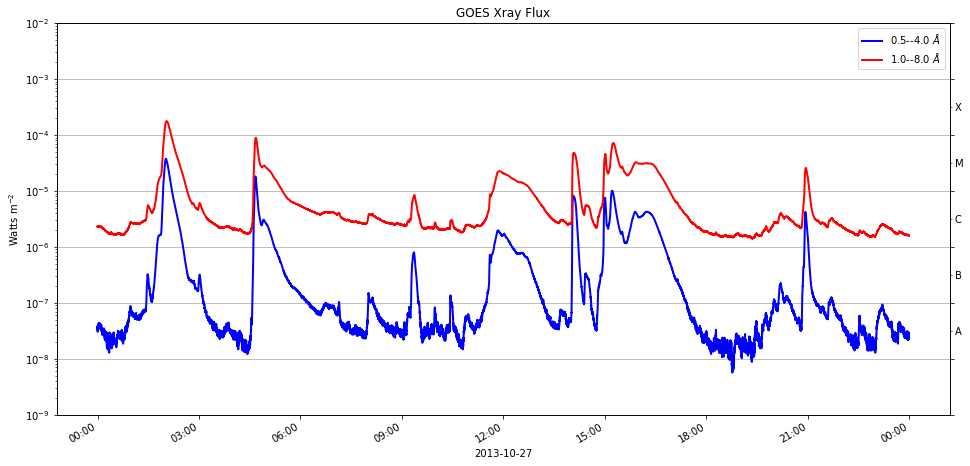

In [15]:
goes_lc[1].peek()

También podemos revisar la meta-inofrmación que tiene el objeto

In [16]:
goes_lc[1].meta

|-------------------------------------------------------------------------------------------------|
|TimeRange                  | Columns         | Meta                                              |
|-------------------------------------------------------------------------------------------------|
|2013-10-27T23:59:33.001082 | xrsa            | conventions: b'ACDD-1.3, Spase v2.2.6'            |
|            to             | xrsb            | title: b'GOES 1-15 L2 XRS high-resolution Irradian|
|2013-10-28T23:59:31.558082 |                 | id: b' '                                          |
|                           |                 | summary: b'The X-ray flux product consists of repr|
|                           |                 | keywords: b'NumericalData.MeasurementType.Irradian|
|                           |                 | keywords_vocabulary: b'SPASE: Space Physics Archiv|
|                           |                 | naming_authority: b'gov.nesdis.noaa'              |


Se pueden inspeccionar las unidades

In [17]:
goes_lc[0].units

OrderedDict([('xrsa', Unit("W / m2")), ('xrsb', Unit("W / m2"))])

También se puede truncar los límites de tiempo en los cuales quisieramos inspeccionar las curvas de luz

In [18]:
sub_lc = goes_lc[0].truncate("2013-10-28T03:00", "2013-10-28T06:00")

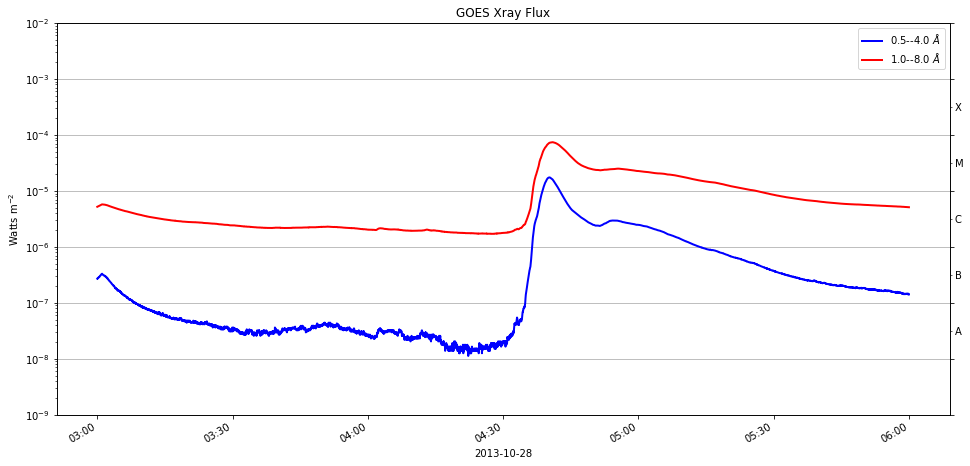

In [19]:
sub_lc.peek()

## Map (mapas, fotogramas, filtergramas, u otros "nombres" para datos 2D)

Desde hace varias décadas atrás, el formato formal y unificado para datos astronómicos son los *fits*. Pero cada instrumento o telescopio puede generar sus archivos *.fits* como ellos lo consideren. La función *Map* en Sunpy brinda una única forma de cargar diferentes tipos de archivos fits de diferentes instrumentos.

Vamos a usar la función *Map* para cargar una de las imágenes que descargamos al principio

In [20]:
aia_map = smap.Map(aia_files_specific[0])

Ahora vamos a graficar

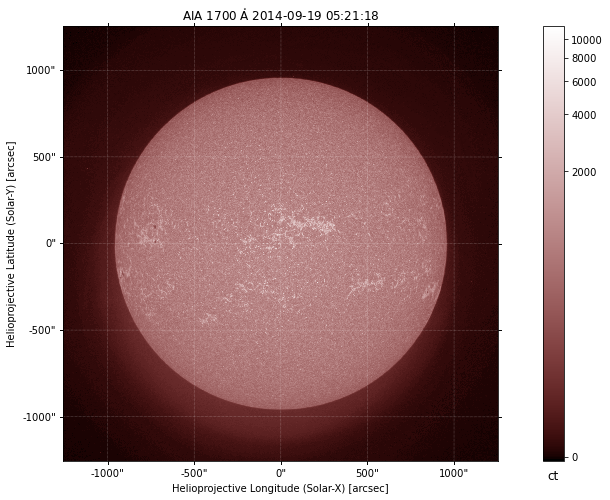

In [21]:
aia_map.peek()

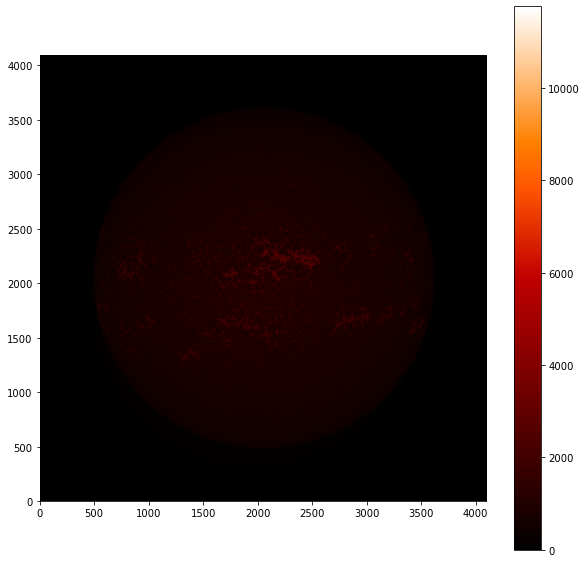

In [23]:
fig, ax = plt.subplots(figsize=(10,10))
im = ax.imshow(aia_map.data,origin='lower',cmap='gist_heat')
fig.colorbar(im,ax=ax)

Ahora podríamos seleccionar una región de interés. Esto se debe hacer generando coordenadas de las esquinas inferior izquierda y superior derecha en formato de coordenadas de astropy SkyCoord, y la función *submap*

In [24]:
top_right = SkyCoord(-500 * u.arcsec, 400 * u.arcsec, frame=aia_map.coordinate_frame)
bottom_left = SkyCoord(-1000 * u.arcsec, -100 * u.arcsec, frame=aia_map.coordinate_frame)
aia_submap = aia_map.submap(bottom_left, top_right=top_right)

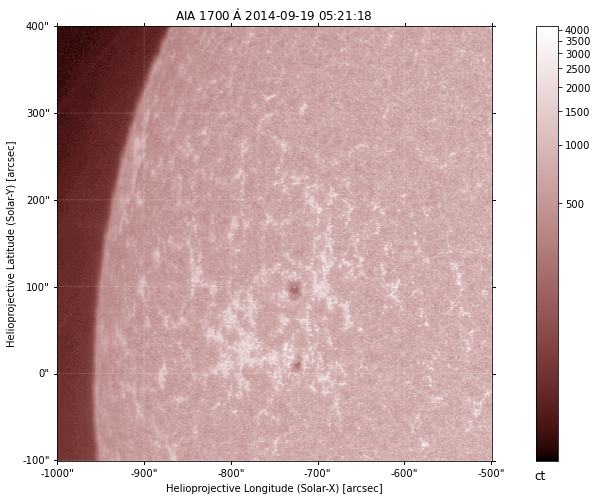

In [25]:
aia_submap.peek()

También podemos agregar contornos a los mapas dependiendo de los valores que necesitamos.

Primero revicemos qué tipos de unidades tiene AIA

In [27]:
print(aia_map.unit)

ct


## Alineando AIA con HMI

Este ejemplo muestra cómo reproyectar una imagen para alinearla con otra imagen.

In [28]:
from reproject import reproject_interp

import sunpy.data.sample

In [29]:
map_aia = sunpy.map.Map(sunpy.data.sample.AIA_171_IMAGE)
map_hmi = sunpy.map.Map(sunpy.data.sample.HMI_LOS_IMAGE)
map_hmi.plot_settings['cmap'] = "hmimag"
map_hmi.plot_settings['norm'] = plt.Normalize(-1500, 1500)

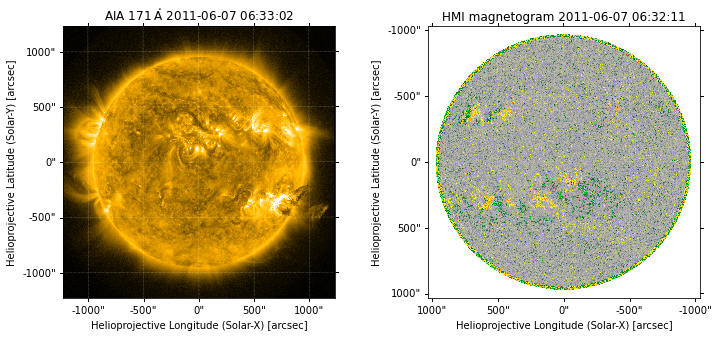

In [30]:
fig = plt.figure(figsize=(12, 5))
ax1 = fig.add_subplot(1, 2, 1, projection=map_aia)
map_aia.plot(axes=ax1, clip_interval=(1, 99.9)*u.percent)
ax2 = fig.add_subplot(1, 2, 2, projection=map_hmi)
map_hmi.plot(axes=ax2)

In [31]:
output, footprint = reproject_interp(map_hmi, map_aia.wcs, map_aia.data.shape)

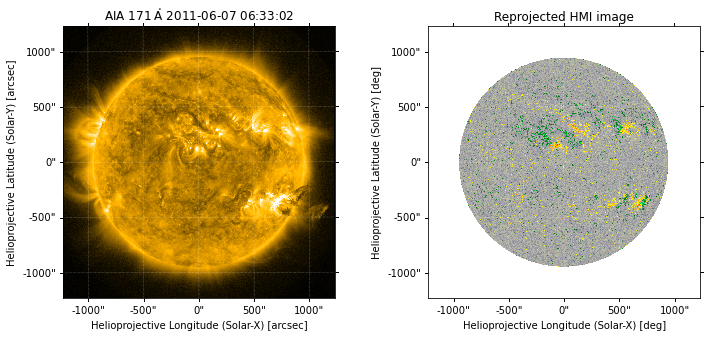

In [32]:
out_hmi = sunpy.map.Map(output, map_aia.wcs)
out_hmi.plot_settings = map_hmi.plot_settings

fig = plt.figure(figsize=(12, 5))
ax1 = fig.add_subplot(1, 2, 1, projection=map_aia)
map_aia.plot(axes=ax1, clip_interval=(1, 99.9)*u.percent)
ax2 = fig.add_subplot(1, 2, 2, projection=out_hmi)
out_hmi.plot(axes=ax2, title='Reprojected HMI image')

Ahora, las dos imágenes tienen la misma grilla de pixel, por lo tanto se pueden graficar una sobre la otra. 

Text(0.5, 1.0, 'HMI overlaid on AIA')

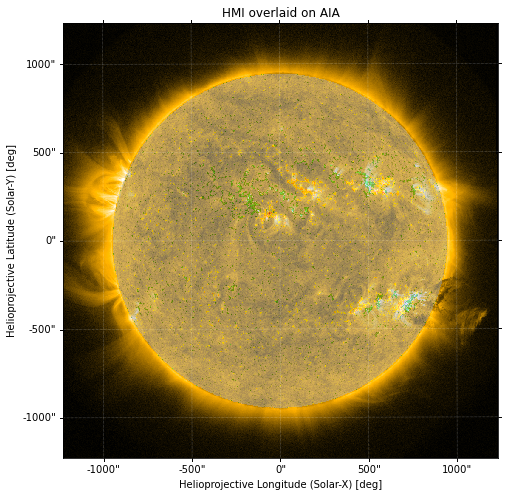

In [33]:
fig = plt.figure()
ax1 = fig.add_subplot(1, 1, 1, projection=map_aia)
map_aia.plot(axes=ax1, clip_interval=(1, 99.9)*u.percent)
out_hmi.plot(axes=ax1, alpha=0.5)
plt.title('HMI overlaid on AIA')

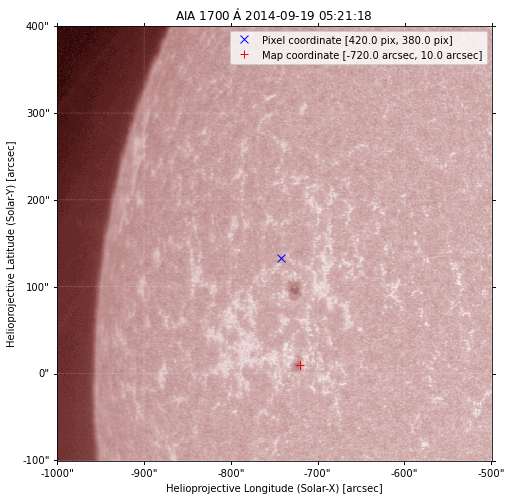

In [34]:
plt.figure()
ax = plt.subplot(projection=aia_submap) #Al ser una gráfica de un objeto 3D en un plano, se usa el argumento projection
aia_submap.plot() 

pixel_coord = [420, 380] * u.pix
ax.plot(pixel_coord[0], pixel_coord[1], 'x', color='blue', markersize=8,
        label=f'Pixel coordinate [{pixel_coord[0]}, {pixel_coord[1]}]')

map_coord = ([-720, 10] * u.arcsec)

ax.plot(map_coord[0].to('deg'), map_coord[1].to('deg'), '+', color='red', transform=ax.get_transform('world'),
        markersize=8,label=f'Map coordinate [{map_coord[0]}, {map_coord[1]}]')
plt.legend()

podemos dibujar rectángulos

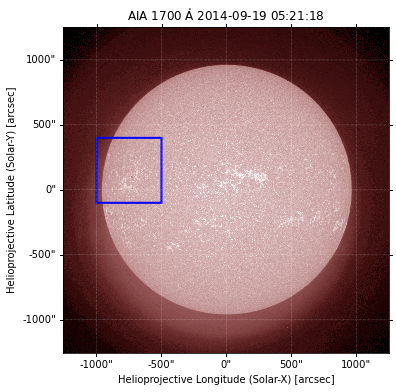

In [35]:
fig = plt.figure(figsize=(6, 6))
fig.add_subplot(111, projection=aia_map)
aia_map.plot(clip_interval=(1, 99.99)*u.percent)

coords = SkyCoord(
    Tx=(-1000, -500) * u.arcsec,
    Ty=(-100, 400) * u.arcsec,
    frame=aia_map.coordinate_frame,
)
aia_map.draw_quadrangle(
    coords,
    edgecolor="blue",
    linestyle="-",
    linewidth=2,
    label='2-element SkyCoord'
)

Podemos hacer regiones cuadrangulares lat-long

In [36]:
bottom_left = SkyCoord(30*u.deg, -10*u.deg,
                       frame=frames.HeliographicStonyhurst, obstime=aia_map.date)

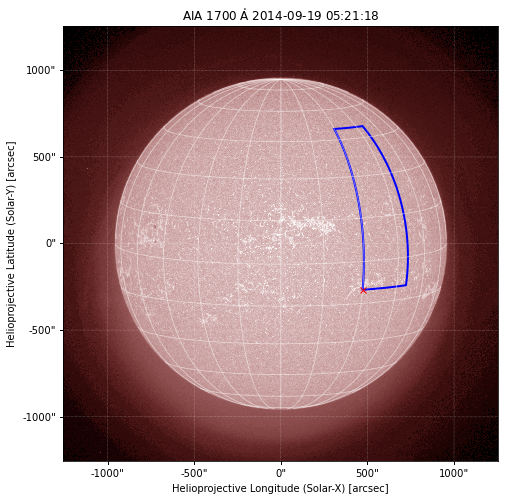

In [37]:
fig = plt.figure()
ax = plt.subplot(projection=aia_map)
aia_map.plot(clip_interval=(1, 99.99)*u.percent)
aia_map.draw_grid()
aia_map.draw_quadrangle(bottom_left, width=20*u.deg, height=60*u.deg,
                    edgecolor='blue', linewidth=2)
ax.plot_coord(bottom_left, 'x', color='red')

plt.show()

Algunos ejemplos de coordenadas

In [38]:
from sunpy.sun import constants

In [39]:
print(constants.mass)
print()
print(constants.radius)
print()
print(constants.luminosity)
print()
print(constants.density)

  Name   = Solar mass
  Value  = 1.9884754153381438e+30
  Uncertainty  = 9.236140093538353e+25
  Unit  = kg
  Reference = IAU 2015 Resolution B 3 + CODATA 2014

  Name   = Nominal solar radius
  Value  = 695700000.0
  Uncertainty  = 0.0
  Unit  = m
  Reference = IAU 2015 Resolution B 3

  Name   = Nominal solar luminosity
  Value  = 3.828e+26
  Uncertainty  = 0.0
  Unit  = W
  Reference = IAU 2015 Resolution B 3

  Name   = Mean density
  Value  = 1409
  Uncertainty  = 0
  Unit  = kg / m3
  Reference = Allen's Astrophysical Quantities 4th Ed.


Podemos aplicar rotación diferencial

In [44]:
from sunpy.physics.differential_rotation import diff_rot

d_long = diff_rot(2 * u.day, 60 * u.deg)

In [45]:
print(d_long)

23d24m50.1955788s


In [47]:
from sunpy.time import TimeRange
time_range = TimeRange('2010/03/04 00:10', '2010/03/04 00:20')
#time_range = TimeRange(('2010/03/04 00:10', '2010/03/04 00:20'))

time_range

    Start: 2010-03-04 00:10:00
    End:   2010-03-04 00:20:00
    Center:2010-03-04 00:15:00
    Duration:0.006944444444444475 days or
           0.1666666666666674 hours or
           10.000000000000044 minutes or
           600.0000000000026 seconds

In [48]:
time_range = TimeRange('2010/03/04 00:10', 600 * u.s)
time_range

    Start: 2010-03-04 00:10:00
    End:   2010-03-04 00:20:00
    Center:2010-03-04 00:15:00
    Duration:0.00694444444444442 days or
           0.16666666666666607 hours or
           9.999999999999964 minutes or
           599.9999999999978 seconds

In [49]:
time1 = '2014/5/5 12:11'
time2 = '2012/5/5 12:11'
time_range = TimeRange('2014/05/04 13:54', '2018/02/03 12:12')

print(time1 in time_range)

print(time2 in time_range)

True
False


In [50]:
from sunpy.instr.iris import SJI_to_sequence

from aiapy.calibrate import register, update_pointing

from matplotlib.patches import Polygon

Observatory,IRIS
Instrument,SJI
Detector,SJI
Measurement,2832.0 Angstrom
Wavelength,2832.0 Angstrom
Observation Date,2014-09-19 05:18:06
Exposure Time,8.00004 s
Dimension,[364. 387.] pix
Coordinate System,helioprojective
Scale,[0.3327 0.3327] arcsec / pix
Reference Pixel,[181.5 193. ] pix

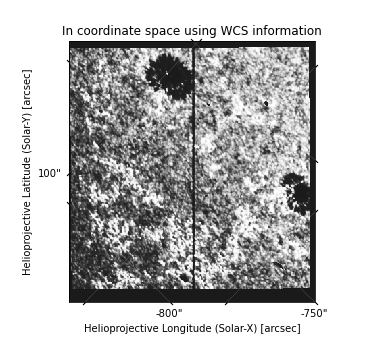
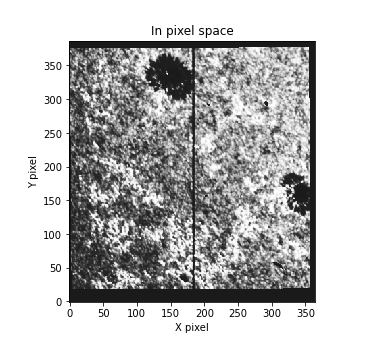
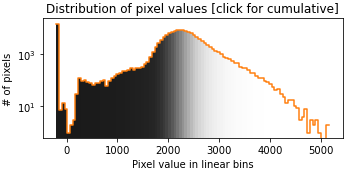
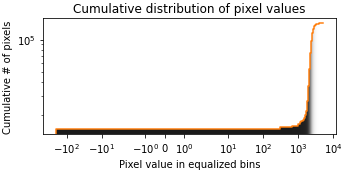
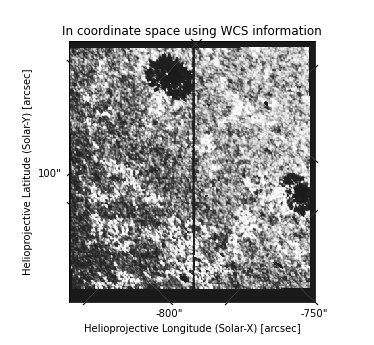
...
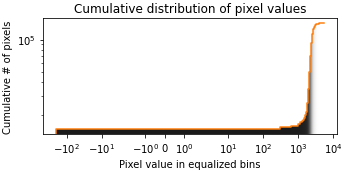
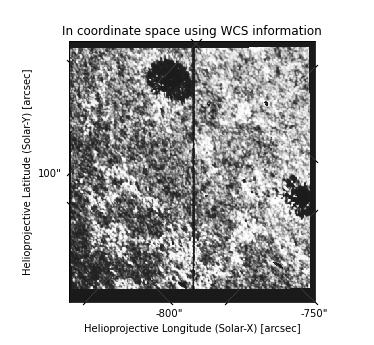
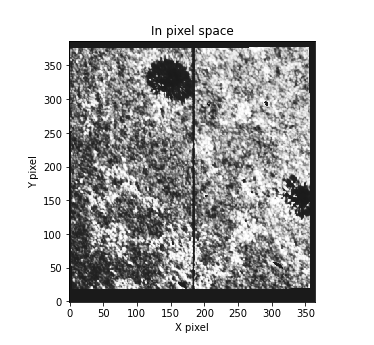
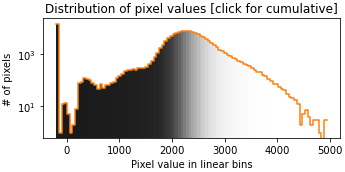
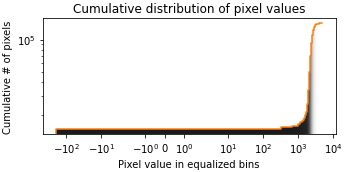

In [51]:
sji = SJI_to_sequence("iris_l2_20140919_051712_3860608353_SJI_2832_t000.fits")
sji

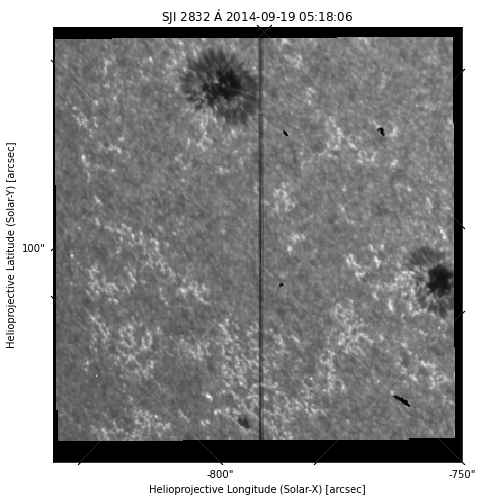

In [53]:
sji[0].plot()

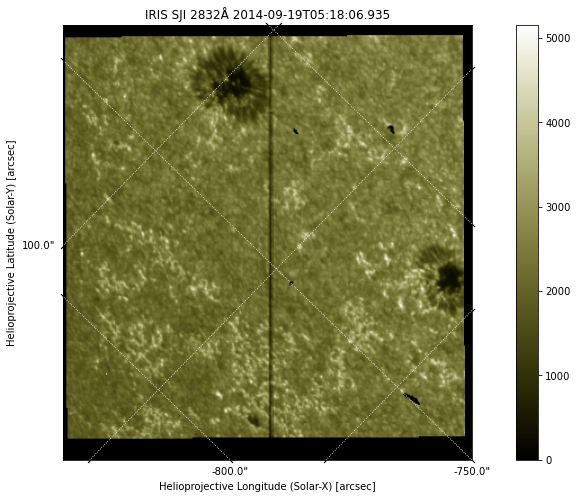

In [54]:
ax = plt.subplot(projection=sji[0].wcs)
img = ax.imshow(sji[0].data, cmap='irissji2832', vmin=0)
ax.coords[0].set_major_formatter('s.s')
ax.coords[1].set_major_formatter('s.s')
ax.grid(color='w', ls=':')
ax.set_xlabel("Helioprojective Longitude (Solar-X) [arcsec]")
ax.set_ylabel("Helioprojective Latitude (Solar-Y) [arcsec]")
ax.set_title("IRIS SJI %.0fÅ %s" % (sji[0].meta['TWAVE1'],
                                    sji[0].date))
plt.colorbar(img, ax=ax)

In [55]:
sji[0].wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'HPLN-TAN'  'HPLT-TAN'  
CRVAL : -0.20729944444444  0.015956055555556  
CRPIX : 182.5  194.0  
PC1_1 PC1_2  : 0.699058055878  0.71506267786  
PC2_1 PC2_2  : -0.71506267786  0.699058055878  
CDELT : 9.2416666666667e-05  9.2416666666667e-05  
NAXIS : 0  0

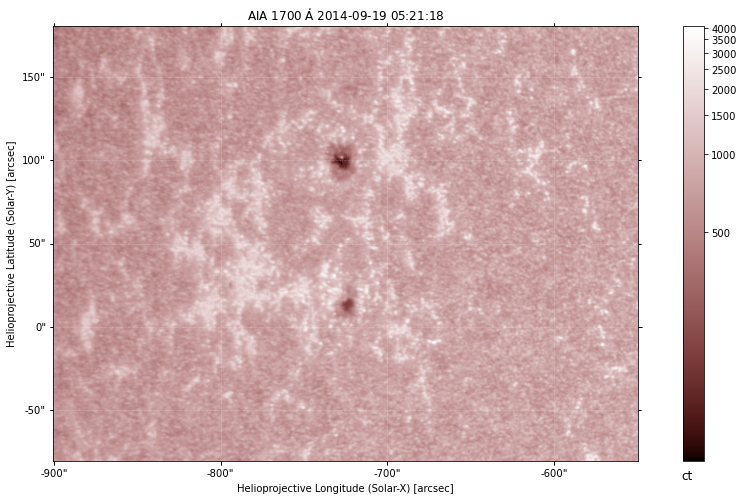

In [56]:
aia_map = update_pointing(aia_map)
aia_map = register(aia_map)

top_right = SkyCoord(-550*u.arcsec, 180*u.arcsec, frame=aia_map.coordinate_frame)
bottom_left = SkyCoord(-900 * u.arcsec, -80. * u.arcsec, frame=aia_map.coordinate_frame)
aia_submap = aia_map.submap(bottom_left,top_right=top_right)
aia_submap.peek()

In [58]:
dims = sji.as_array().shape
points = sji[0].pixel_to_world((0,dims[1]-1,dims[1]-1,0)*u.pix,
                                   (0,0,dims[0]-1,dims[0]-1)*u.pix)

iris_points = np.array([points.Tx.value, points.Ty.value, ]).T
iris_points

array([[-834.40561462,   55.73360374],
       [-749.98030516,  -30.62457693],
       [-658.15038497,   59.14998578],
       [-742.57569396,  145.50817691]])